# Time series decomposition

## On four coins selected from each cluster

BNB, BTC, ETH and LTC.

In [4]:
from pycaret.time_series import *
import pandas as pd
import sys
sys.path.append('..')
from backend.app.fetch_data_bifinance import BinanceDataFetcher

In [30]:
# setting a static renderer so the notebook size is reduced
fig_kwargs = {
    "renderer": "png",
    "width": 1000,
    "height": 700,
}

In [ ]:
# repeat time series decomp for other selected coins.
selected_coins = ['BNBUSDT', 'BTCUSDT', 'ETHUSDT', 'LTCUSDT']
# obtain 5 yr data for each coin
# Selected trading pairs to fetch
# multi_data = BinanceDataFetcher("../backend/data").fetch_multiple_pairs(selected_coins)

Fetching 5 years of 1d data for BNBUSDT...
Fetched 1000 candles. Total: 1000
Fetched 825 candles. Total: 1825
Successfully fetched 1825 data points for BNBUSDT
Data saved to ../backend/data/bnbusdt_1d.csv
Fetching 5 years of 1d data for BTCUSDT...
Fetched 1000 candles. Total: 1000
Fetched 825 candles. Total: 1825
Successfully fetched 1825 data points for BTCUSDT
Data saved to ../backend/data/btcusdt_1d.csv
Fetching 5 years of 1d data for ETHUSDT...
Fetched 1000 candles. Total: 1000
Fetched 825 candles. Total: 1825
Successfully fetched 1825 data points for ETHUSDT
Data saved to ../backend/data/ethusdt_1d.csv
Fetching 5 years of 1d data for LTCUSDT...
Fetched 1000 candles. Total: 1000
Fetched 825 candles. Total: 1825
Successfully fetched 1825 data points for LTCUSDT
Data saved to ../backend/data/ltcusdt_1d.csv


In [18]:
df = pd.read_csv(f"../backend/data/bnbusdt_1d.csv", parse_dates=True, index_col=0)

df.head()

,symbol,open,high,low,close,volume
timestamp,,,,,,
2020-04-20,BNBUSDT,16.0677,16.4499,14.8219,14.9892,3219905.90
2020-04-21,BNBUSDT,14.9840,15.4416,14.6945,15.1283,3137524.29
2020-04-22,BNBUSDT,15.1381,15.8030,14.9112,15.7104,3296897.61
2020-04-23,BNBUSDT,15.7103,16.4666,15.4102,16.0340,3457409.45
2020-04-24,BNBUSDT,16.0502,16.2568,15.6800,15.9319,3008320.26


,Description,Value
0,session_id,903
1,Target,close
2,Approach,Univariate
3,Exogenous Variables,Present
4,Original data shape,"(1825, 5)"
5,Transformed data shape,"(1825, 5)"
6,Transformed train set shape,"(1795, 5)"
7,Transformed test set shape,"(30, 5)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


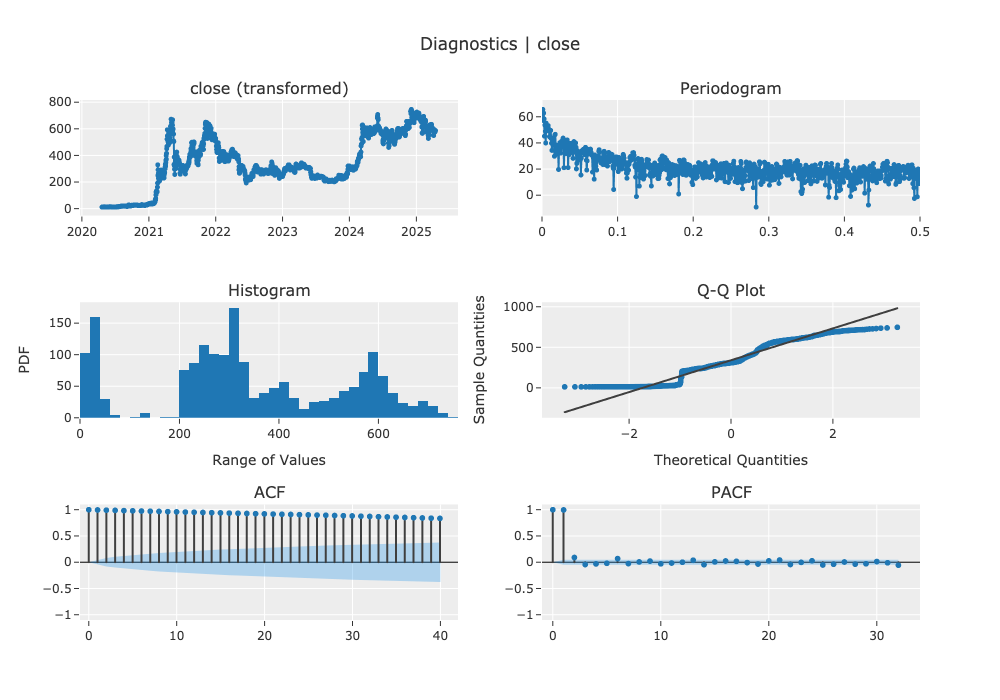

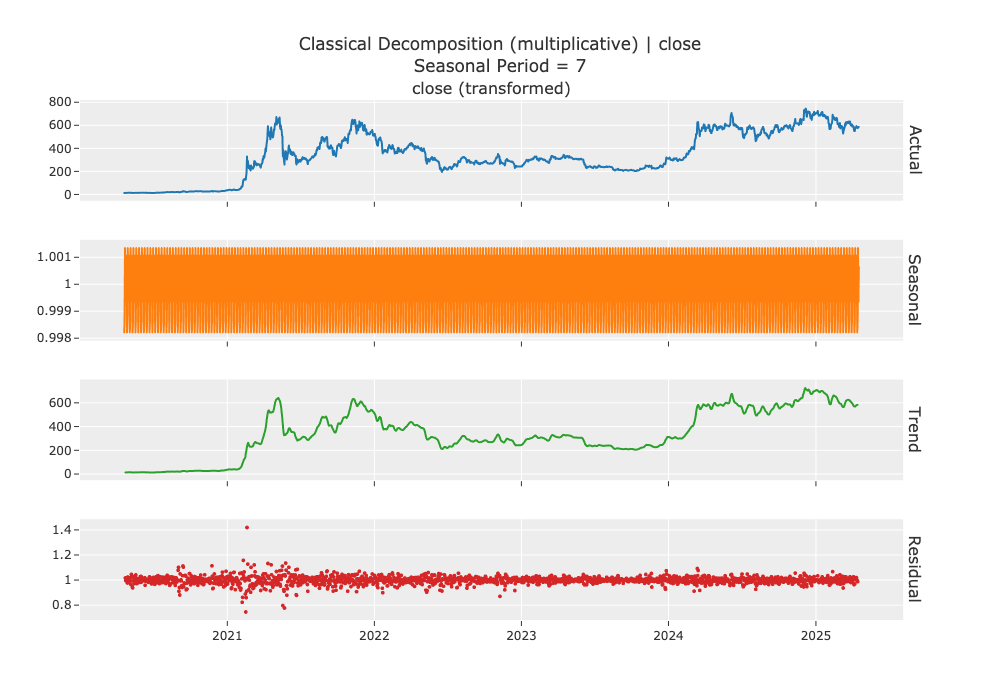

,Description,Value
0,session_id,413
1,Target,close
2,Approach,Univariate
3,Exogenous Variables,Present
4,Original data shape,"(1825, 5)"
5,Transformed data shape,"(1825, 5)"
6,Transformed train set shape,"(1795, 5)"
7,Transformed test set shape,"(30, 5)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


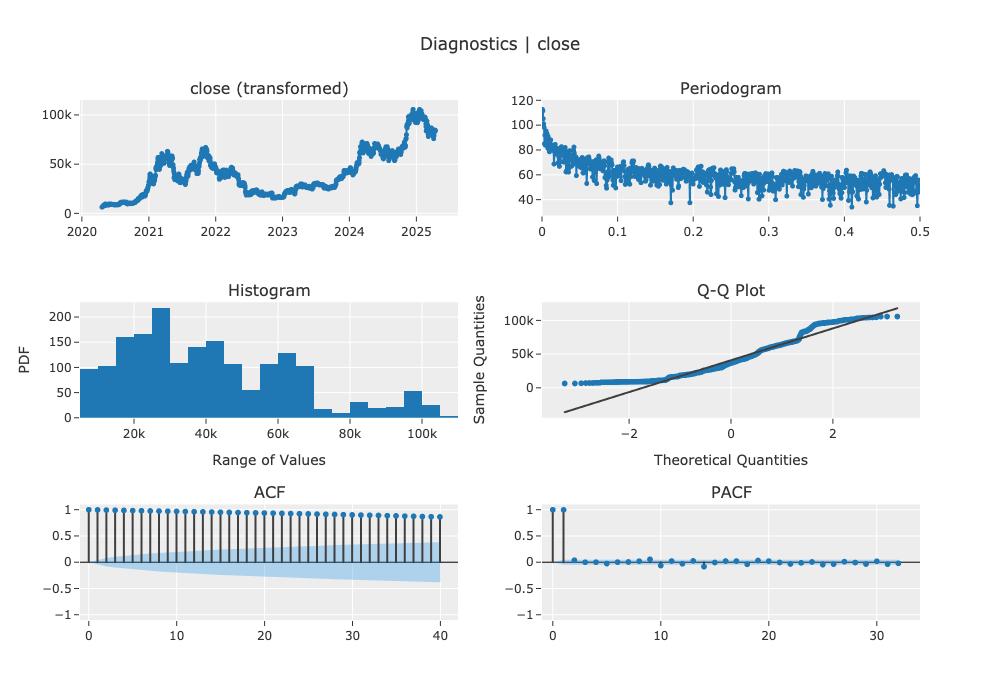

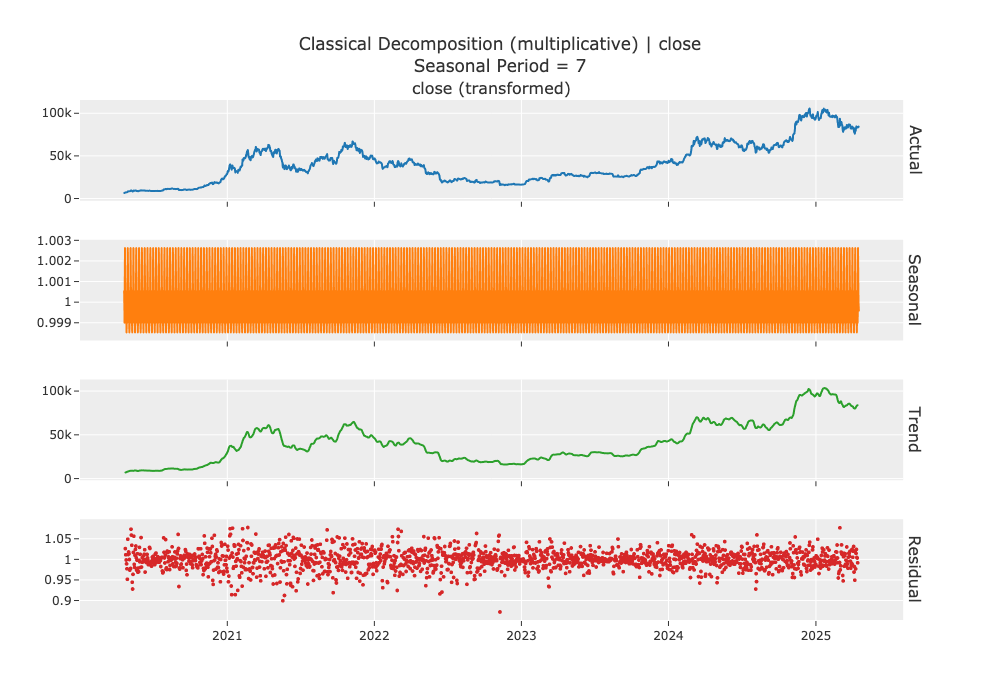

,Description,Value
0,session_id,1007
1,Target,close
2,Approach,Univariate
3,Exogenous Variables,Present
4,Original data shape,"(1825, 5)"
5,Transformed data shape,"(1825, 5)"
6,Transformed train set shape,"(1795, 5)"
7,Transformed test set shape,"(30, 5)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


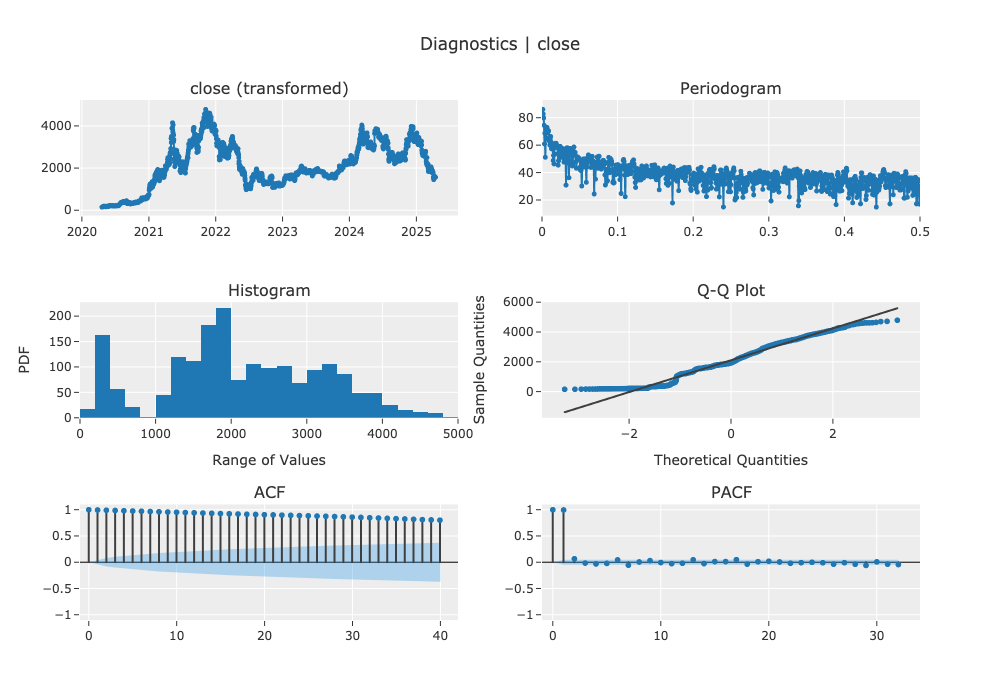

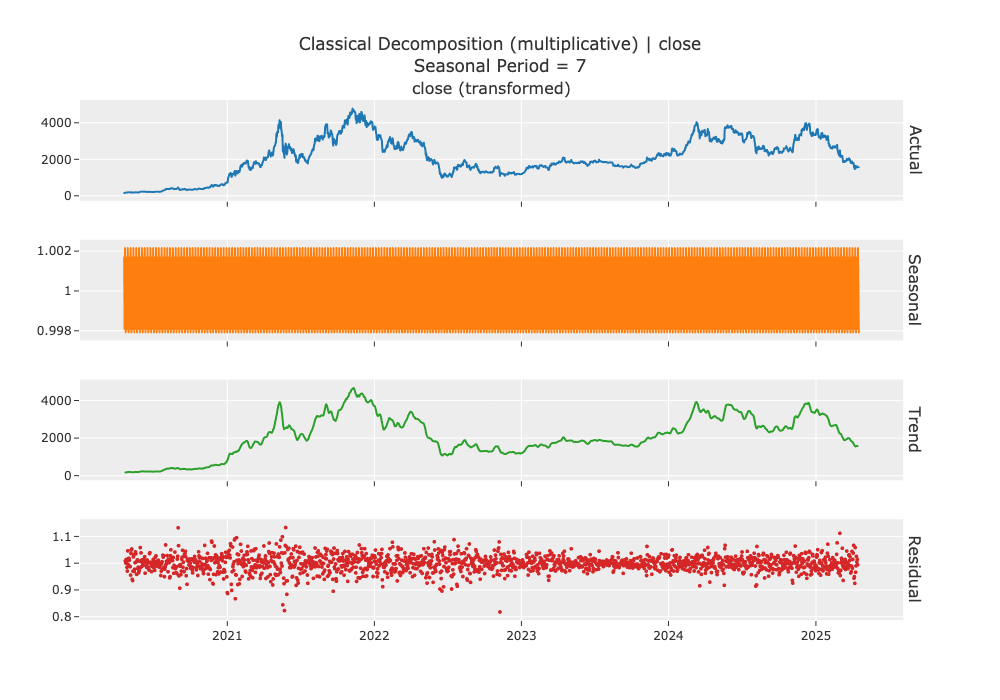

,Description,Value
0,session_id,556
1,Target,close
2,Approach,Univariate
3,Exogenous Variables,Present
4,Original data shape,"(1825, 5)"
5,Transformed data shape,"(1825, 5)"
6,Transformed train set shape,"(1795, 5)"
7,Transformed test set shape,"(30, 5)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


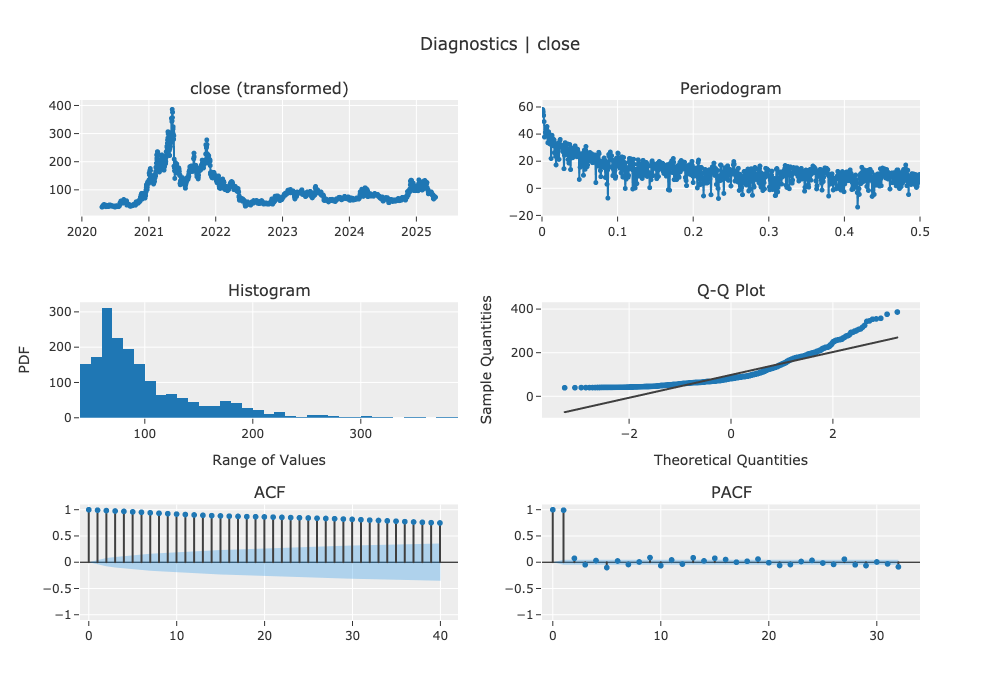

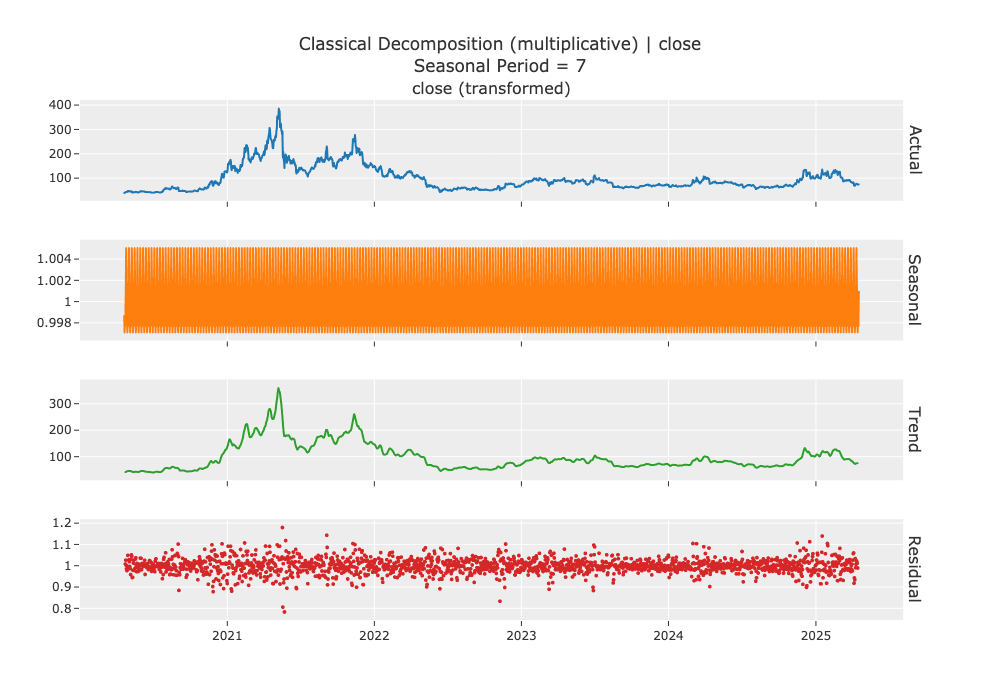

In [51]:
# setup a TSForecastingExperiment
import random

random.seed(1234)
experiments = []
for coin in selected_coins:
    exp = TSForecastingExperiment().setup(
        data=pd.read_csv(f"../backend/data/{coin.lower()}_1d.csv", parse_dates=True, index_col=0),
        fh=30,
        target="close",
        seasonal_period='D',
        ignore_features='symbol',
        experiment_name=f"{coin}_experiment",
        fig_kwargs=fig_kwargs,
        # transform_target='log',
        session_id=random.randrange(1, 1234)
        )
    # plot trend analysis, correlations and distribution
    exp.plot_model(plot="diagnostics")
    # plot decomp (addtivie and multiplicative)
    exp.plot_model(plot='decomp', fig_kwargs={'renderer': 'notebook'})
    exp.plot_model(plot='decomp', data_kwargs = {'type' : 'multiplicative'})
    experiments.append(exp)



In [52]:
# stationarity test

for exp in experiments:
    print(exp.check_stats(test='adf').to_markdown())

|    | Test         | Test Name   | Data        | Property           | Setting         |     Value |
|---:|:-------------|:------------|:------------|:-------------------|:----------------|----------:|
|  0 | Stationarity | ADF         | Transformed | Stationarity       | {'alpha': 0.05} |  0        |
|  1 | Stationarity | ADF         | Transformed | p-value            | {'alpha': 0.05} |  0.397892 |
|  2 | Stationarity | ADF         | Transformed | Test Statistic     | {'alpha': 0.05} | -1.76516  |
|  3 | Stationarity | ADF         | Transformed | Critical Value 1%  | {'alpha': 0.05} | -3.43395  |
|  4 | Stationarity | ADF         | Transformed | Critical Value 5%  | {'alpha': 0.05} | -2.86313  |
|  5 | Stationarity | ADF         | Transformed | Critical Value 10% | {'alpha': 0.05} | -2.56762  |
|    | Test         | Test Name   | Data        | Property           | Setting         |     Value |
|---:|:-------------|:------------|:------------|:-------------------|:----------------|---

# time lagged analysis

## PACF

the four selected coins have a significant partial autocorrelation of 2 time lags.


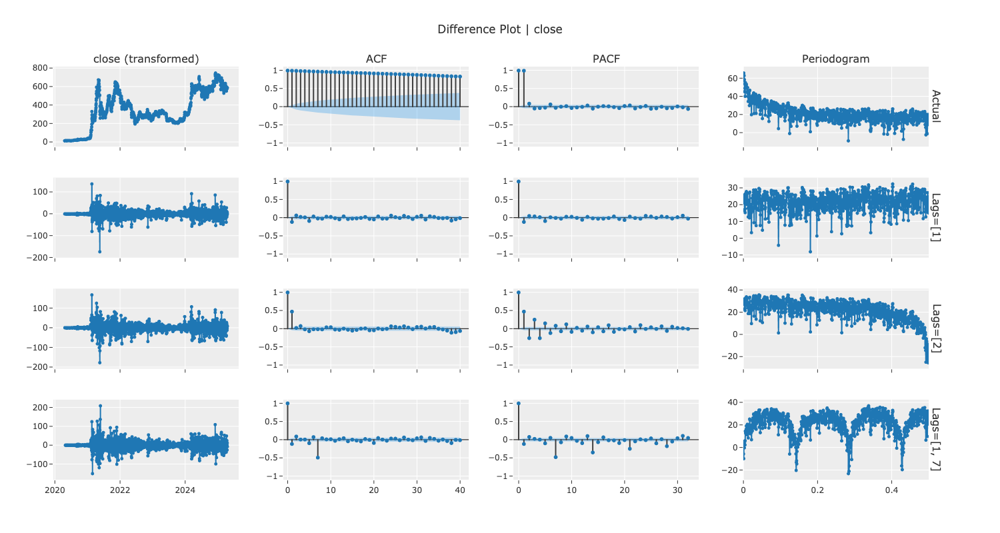

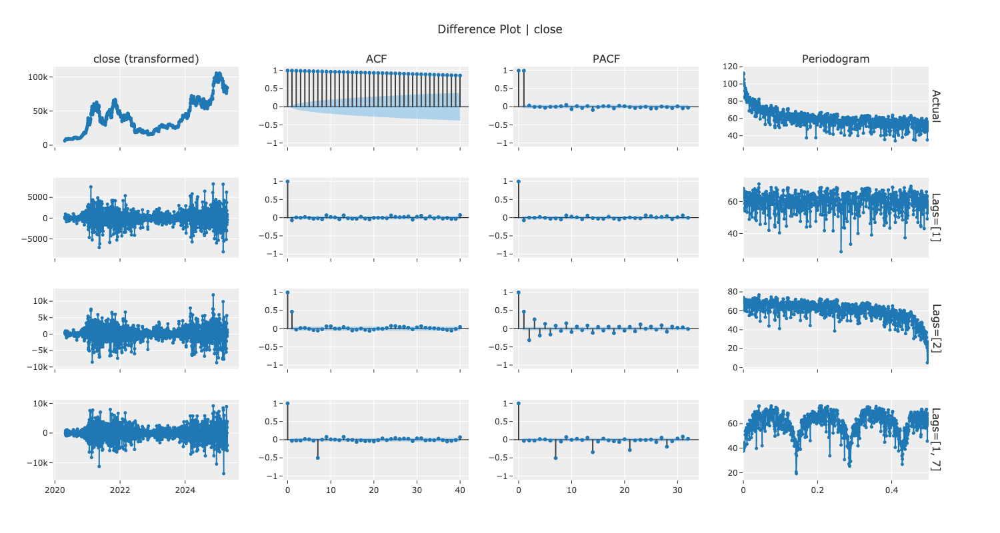

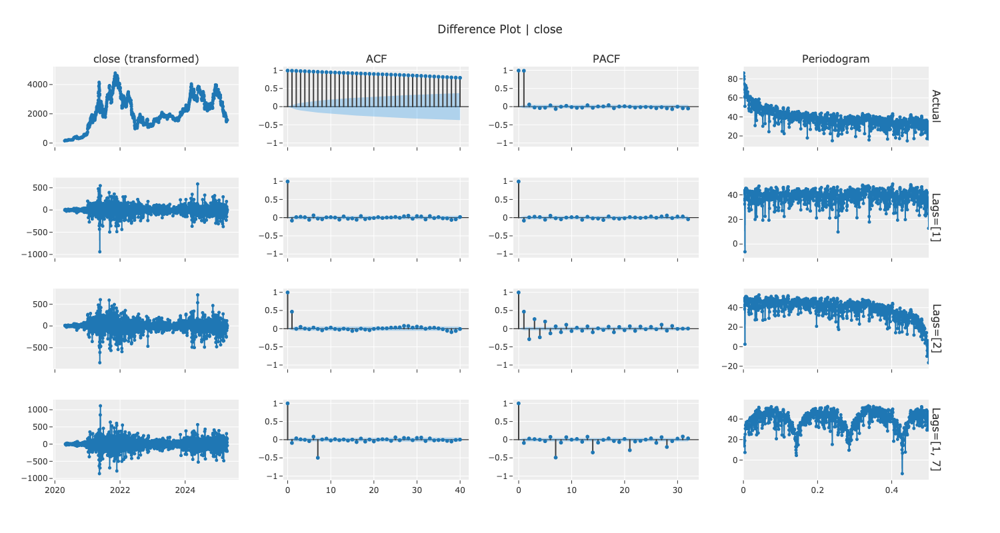

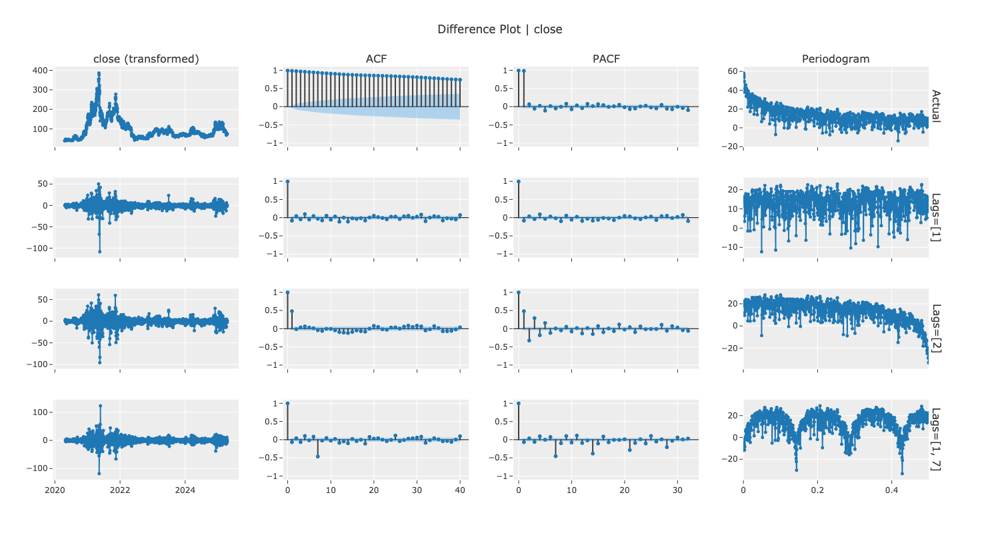

In [53]:
for exp in experiments:
    exp.plot_model(
        plot="diff",
        data_kwargs={"lags_list": [[1], [2], [1,7]], "acf": True, "pacf": True, "periodogram": True},
        fig_kwargs={"height": 800, "width": 1500}
    )

it may not be possible to make the data stationary unless log (or equivalent transform is performed)
there is no true seasonaility of the data
no true trend over the past 5 years

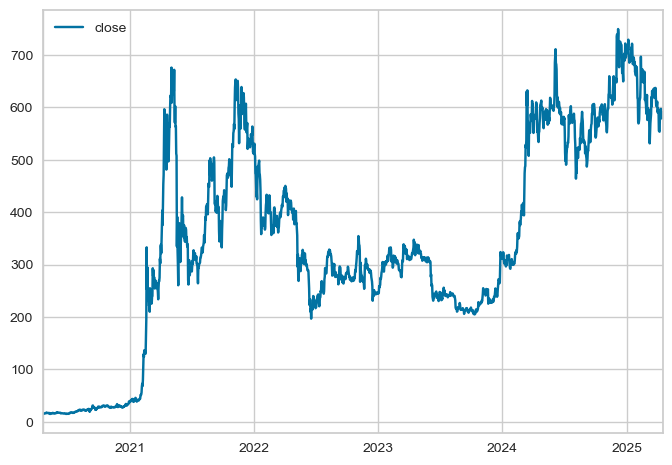

In [70]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
# Ensure plots are displayed inline in the notebook
%matplotlib inline

def transform_and_plot(df: pd.DataFrame, method='log', column='close'):
    # grab the column(s)
    data = df.copy()
    close_log, _ = stats.boxcox(data['close'].values)
    data.insert(loc=list(data.columns).index('close')+1, column="close_log", value=close_log)
    # print(df.head(1).to_markdown())
    ax = data.plot(kind='line', y='close')
    plt.show()
    # return data
    
test: TSForecastingExperiment = experiments[0]
transform_and_plot(test.dataset)    



based on this is may be worth exprimenting fully with bootsing models that train iteratively on residuals (e.g XGBoost, ADABoost)
additionally due to the long term autocorrelation with no seasonailty, it may also be worth experimenting with models that give weight to short term observations